# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import classification_report,confusion_matrix

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

# Importing breast cancer data set

In [2]:
cancer_df = pd.read_csv('breast-cancer-wisconsin-data.csv')
cancer_df.shape

(569, 32)

In [3]:
cancer_df.head()

,ID Number,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,...,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension,Diagnosis
0,842302,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,M
1,842517,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,M
2,84300903,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,M
3,84348301,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,M
4,84358402,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,M


In [4]:
cancer_df.tail()

,ID Number,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,...,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension,Diagnosis
564,926424,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,M
565,926682,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,M
566,926954,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,M
567,927241,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,M
568,92751,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,0.1587,...,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039,B


In [5]:
cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
ID Number                  569 non-null int64
Mean Radius                569 non-null float64
Mean Texture               569 non-null float64
Mean Perimeter             569 non-null float64
Mean Area                  569 non-null float64
Mean Smoothness            569 non-null float64
Mean Compactness           569 non-null float64
Mean Concavity             569 non-null float64
Mean Concave Points        569 non-null float64
Mean Symmetry              569 non-null float64
Mean Fractal Dimension     569 non-null float64
Radius SE                  569 non-null float64
Texture SE                 569 non-null float64
Perimeter SE               569 non-null float64
Area SE                    569 non-null float64
Smoothness SE              569 non-null float64
Compactness SE             569 non-null float64
Concavity SE               569 non-null float64
Concave Points SE          569 no

In [6]:
cancer_df.describe()

,ID Number,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,...,Worst Radius,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [7]:
clean_up_diagnosis = {"Diagnosis": {"M": 0,"B":1}}
cancer_df.replace(clean_up_diagnosis, inplace =True)
cancer_df.head()

,ID Number,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,...,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension,Diagnosis
0,842302,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,842517,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,84300903,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,84348301,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,84358402,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


# Exploratory Data Analysis

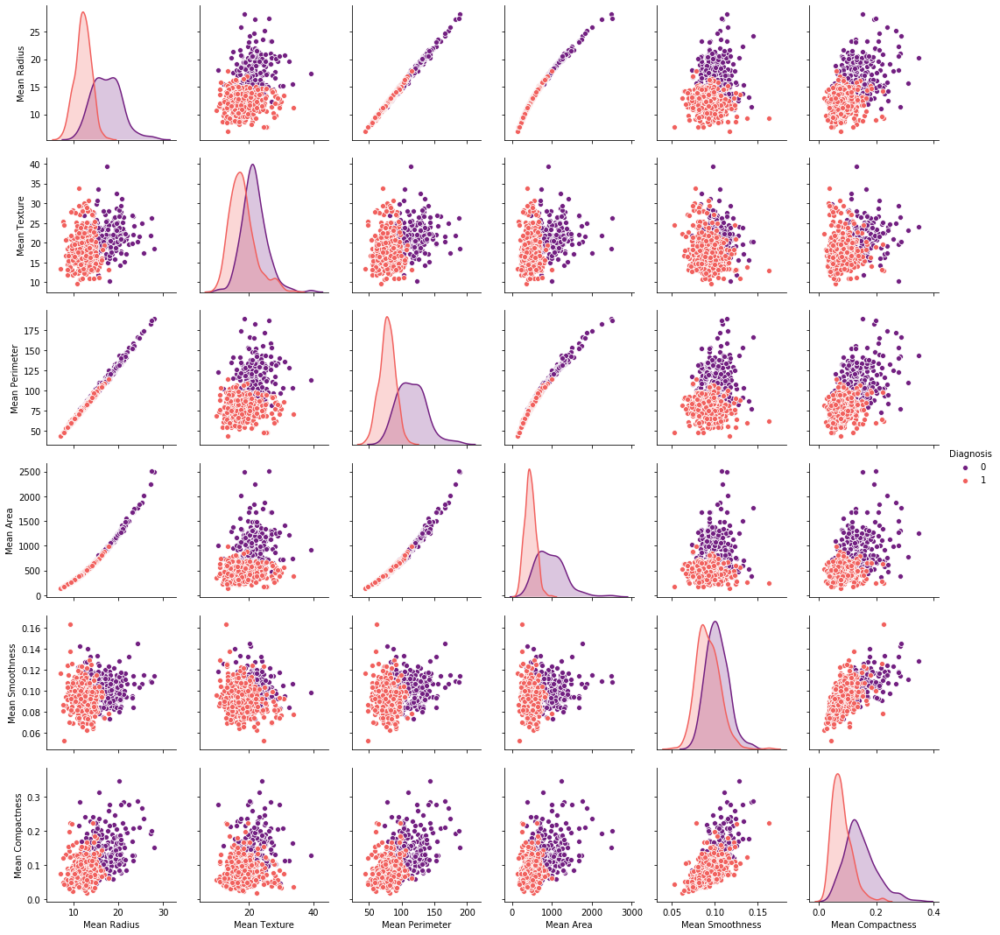

In [8]:
sns.pairplot(data = cancer_df, vars =['Mean Radius','Mean Texture', 'Mean Perimeter', 'Mean Area','Mean Smoothness','Mean Compactness'],hue='Diagnosis', palette = 'magma')

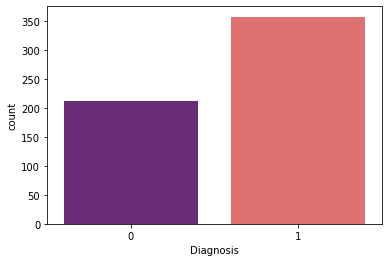

In [9]:
sns.countplot(cancer_df['Diagnosis'],label = 'count', palette = 'magma')

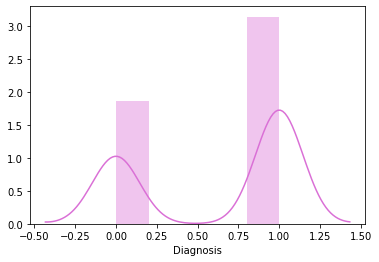

In [10]:
sns.distplot(cancer_df['Diagnosis'],color= 'orchid')

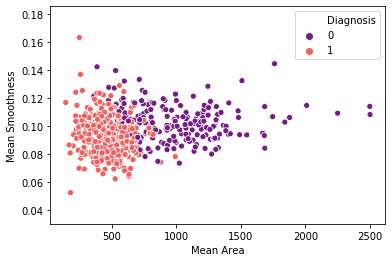

In [11]:
sns.scatterplot( x= 'Mean Area',y= 'Mean Smoothness', data= cancer_df, hue ='Diagnosis',palette='magma')

In [12]:
cancer_df_mean = cancer_df.ix[:,1:11]

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f5c2c10fb50>,
      dtype=object)

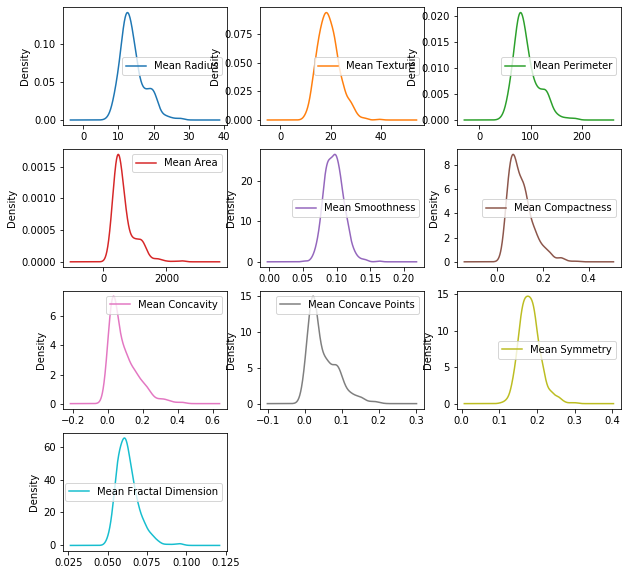

In [13]:
cancer_df_mean.plot(kind='density', subplots=True, layout=(4,3), figsize=(10,10), sharey=False, sharex=False, fontsize= 10)

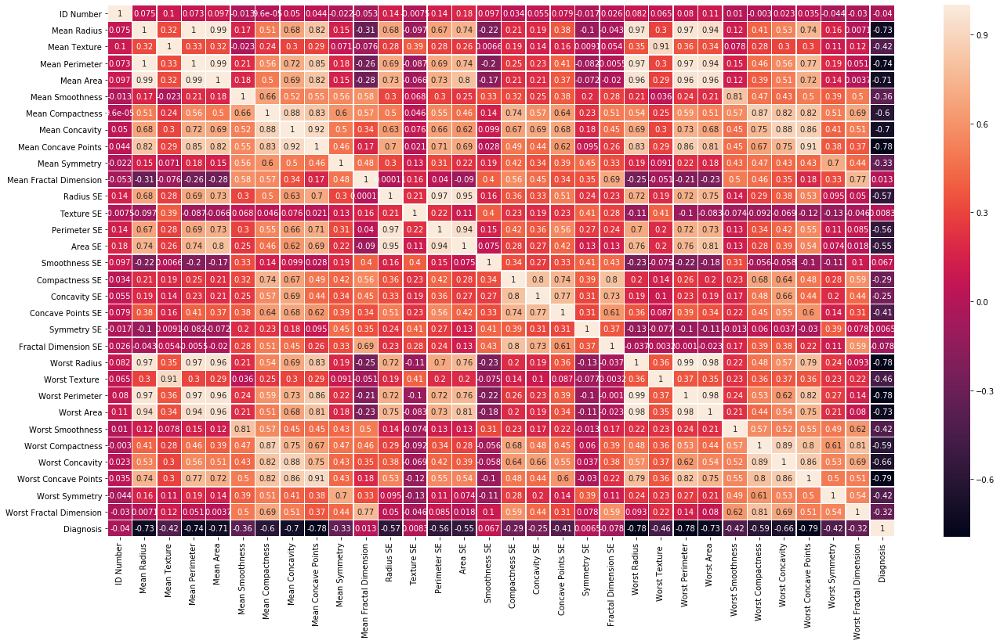

In [14]:
plt.figure(figsize=(22.5,12.5))
sns.heatmap(cancer_df.corr(),annot=True, lw=0.5)

In [15]:
X = cancer_df.drop(['Diagnosis', 'ID Number'],axis=1)
X.shape

(569, 30)

In [16]:
X.head()

,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,Mean Fractal Dimension,...,Worst Radius,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [17]:
X.tail()

,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,Mean Fractal Dimension,...,Worst Radius,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400
568,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,0.1587,0.05884,...,9.456,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039


In [18]:
y = cancer_df['Diagnosis']
y.shape

(569,)

In [19]:
y.head()

0    0
1    0
2    0
3    0
4    0
Name: Diagnosis, dtype: int64

In [20]:
y.tail()

564    0
565    0
566    0
567    0
568    1
Name: Diagnosis, dtype: int64

# Train - Test Split and Model Training

In [21]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3)

print(f' X train Shape: {X_train.shape}')
print(f' X test Shape: {X_test.shape}')
print(f' y train Shape: {y_train.shape}')
print(f' y test Shape: {y_test.shape}')

 X train Shape: (398, 30)
 X test Shape: (171, 30)
 y train Shape: (398,)
 y test Shape: (171,)


              precision    recall  f1-score   support

           0       0.00      0.00      0.00        69
           1       0.60      1.00      0.75       102

    accuracy                           0.60       171
   macro avg       0.30      0.50      0.37       171
weighted avg       0.36      0.60      0.45       171



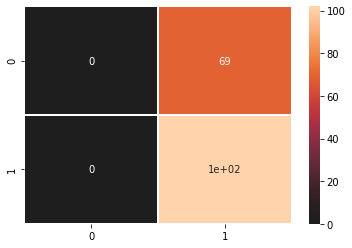

In [22]:
svc= SVC()
svc.fit(X_train,y_train)
y_pred = svc.predict(X_test)

cm= confusion_matrix(y_test,y_pred)
sns.heatmap(cm, annot=True,center=True, lw=0.5)

print(classification_report(y_test,y_pred))

In [23]:
#Scaled values - Training set

min_train = X_train.min()
range_train = (X_train - min_train).max()
X_train_scaled = (X_train - min_train) /range_train

X_train_scaled

,Mean Radius,Mean Texture,Mean Perimeter,Mean Area,Mean Smoothness,Mean Compactness,Mean Concavity,Mean Concave Points,Mean Symmetry,Mean Fractal Dimension,...,Worst Radius,Worst Texture,Worst Perimeter,Worst Area,Worst Smoothness,Worst Compactness,Worst Concavity,Worst Concave Points,Worst Symmetry,Worst Fractal Dimension
153,0.197312,0.113967,0.187133,0.101124,0.515200,0.097387,0.048247,0.093361,0.388889,0.242193,...,0.144433,0.121799,0.128692,0.062820,0.415572,0.060560,0.056837,0.199782,0.307436,0.083169
101,0.000000,0.125803,0.000000,0.000000,0.738442,0.172689,0.000000,0.000000,0.439394,0.616292,...,0.000000,0.214001,0.000000,0.000000,0.576042,0.090142,0.000000,0.000000,0.324780,0.254362
313,0.215770,0.034156,0.206897,0.112662,0.382471,0.123643,0.033277,0.046560,0.390404,0.241101,...,0.156884,0.024189,0.153494,0.069455,0.251139,0.131278,0.066486,0.171081,0.433595,0.126591
143,0.280136,0.210010,0.276069,0.156394,0.391649,0.232225,0.119133,0.161422,0.362626,0.270583,...,0.233013,0.278884,0.232880,0.112711,0.396421,0.220731,0.166933,0.367199,0.471371,0.171455
341,0.124237,0.241123,0.123350,0.058112,0.369164,0.223606,0.205015,0.119812,0.492929,0.464949,...,0.100320,0.314456,0.103790,0.041388,0.344251,0.304945,0.346725,0.294630,0.336660,0.283419
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
546,0.158029,0.224552,0.148711,0.076946,0.478490,0.093737,0.024635,0.028725,0.416667,0.263158,...,0.118107,0.277462,0.103143,0.049081,0.378591,0.059309,0.035016,0.086393,0.265146,0.124295
137,0.210564,0.192087,0.202267,0.108717,0.502008,0.151862,0.085273,0.150288,0.340404,0.189779,...,0.156172,0.284576,0.147019,0.068030,0.315856,0.133413,0.111741,0.307547,0.263958,0.082710
42,0.572152,0.510653,0.583996,0.407423,0.437995,0.612294,0.512902,0.520700,0.631313,0.294169,...,0.574884,0.601878,0.632452,0.360254,0.353497,0.695744,0.578435,0.904572,0.737705,0.319822
126,0.313739,0.506595,0.303849,0.182015,0.458300,0.181707,0.128651,0.161265,0.354040,0.247652,...,0.318748,0.672168,0.312715,0.163070,0.501420,0.253330,0.303195,0.482221,0.452602,0.157156


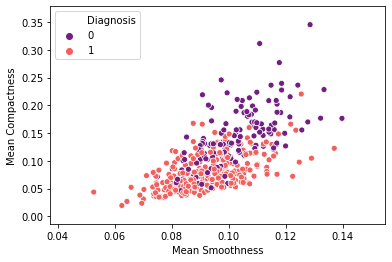

In [24]:
sns.scatterplot(x=X_train['Mean Smoothness'], y=X_train['Mean Compactness'], data=X_train_scaled, hue = y_train, palette = 'magma')

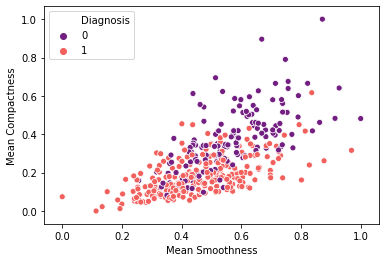

In [25]:
sns.scatterplot(x=X_train_scaled['Mean Smoothness'], y=X_train_scaled['Mean Compactness'], data=X_train_scaled, hue = y_train, palette = 'magma')

In [26]:
#Scaled values - Test set

min_test = X_test.min()
range_test = (X_test - min_test).max()
X_test_scaled = (X_test - min_test)/range_test

# Model Testing

              precision    recall  f1-score   support

           0       0.95      0.88      0.92        69
           1       0.93      0.97      0.95       102

    accuracy                           0.94       171
   macro avg       0.94      0.93      0.93       171
weighted avg       0.94      0.94      0.94       171



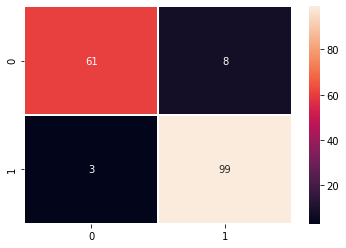

In [27]:
svc.fit(X_train_scaled,y_train)
y_pred = svc.predict(X_test_scaled)

cm = confusion_matrix(y_test,y_pred)
sns.heatmap(cm,annot = True, lw=0.5)

print(classification_report(y_test,y_pred))

# Hyper - Tuning Parameters

In [28]:
param_grid = {'C' : np.linspace(0.01,100,150), 'gamma': np.linspace(0.001,1,150), 'kernel': ['rbf','poly','linear'] }
grid = GridSearchCV(SVC(), param_grid, refit = True, verbose=4)
grid.fit(X_train_scaled, y_train)

Fitting 3 folds for each of 67500 candidates, totalling 202500 fits
[CV] C=0.01, gamma=0.001, kernel=rbf .................................
[CV] ..... C=0.01, gamma=0.001, kernel=rbf, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=rbf .................................
[CV] ..... C=0.01, gamma=0.001, kernel=rbf, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=rbf .................................
[CV] ..... C=0.01, gamma=0.001, kernel=rbf, score=0.644, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=poly ................................
[CV] .... C=0.01, gamma=0.001, kernel=poly, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=poly ................................
[CV] .... C=0.01, gamma=0.001, kernel=poly, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=poly ................................
[CV] .... C=0.01, gamma=0.001, kernel=poly, score=0.644, total=   0.0s
[CV] C=0.01, gamma=0.001, kernel=linear ..............................
[CV] .. C

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s


[CV]  C=0.01, gamma=0.027818791946308725, kernel=rbf, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=rbf ..................
[CV]  C=0.01, gamma=0.027818791946308725, kernel=rbf, score=0.644, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=poly .................
[CV]  C=0.01, gamma=0.027818791946308725, kernel=poly, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=poly .................
[CV]  C=0.01, gamma=0.027818791946308725, kernel=poly, score=0.639, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=poly .................
[CV]  C=0.01, gamma=0.027818791946308725, kernel=poly, score=0.644, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=linear ...............
[CV]  C=0.01, gamma=0.027818791946308725, kernel=linear, score=0.707, total=   0.0s
[CV] C=0.01, gamma=0.027818791946308725, kernel=linear ...............
[CV]  C=0.01, gamma=0.027818791946308725, kernel=linear, score=0.707, total=   0.0

[Parallel(n_jobs=1)]: Done 202500 out of 202500 | elapsed: 13.2min finished


GridSearchCV(cv='warn', error_score='raise-deprecating',
             estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
                           decision_function_shape='ovr', degree=3,
                           gamma='auto_deprecated', kernel='rbf', max_iter=-1,
                           probability=False, random_state=None, shrinking=True,
                           tol=0.001, verbose=False),
             iid='warn', n_jobs=None,
             param_grid={'C': array([1.00000000e-02, 6.81073...
       0.83908725, 0.84579195, 0.85249664, 0.85920134, 0.86590604,
       0.87261074, 0.87931544, 0.88602013, 0.89272483, 0.89942953,
       0.90613423, 0.91283893, 0.91954362, 0.92624832, 0.93295302,
       0.93965772, 0.94636242, 0.95306711, 0.95977181, 0.96647651,
       0.97318121, 0.97988591, 0.9865906 , 0.9932953 , 1.        ]),
                         'kernel': ['rbf', 'poly', 'linear']},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
   

In [29]:
print(f' Grid Search Best Parameters: \n\n {grid.best_params_} \n')
print(f' Grid Search Best Estimator: \n\n {grid.best_estimator_} \n')

 Grid Search Best Parameters: 

 {'C': 0.6810738255033557, 'gamma': 0.7116979865771812, 'kernel': 'poly'} 

 Grid Search Best Estimator: 

 SVC(C=0.6810738255033557, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.7116979865771812,
    kernel='poly', max_iter=-1, probability=False, random_state=None,
    shrinking=True, tol=0.001, verbose=False) 



# Final Model and Predictions

              precision    recall  f1-score   support

           0       0.93      0.97      0.95        69
           1       0.98      0.95      0.97       102

    accuracy                           0.96       171
   macro avg       0.96      0.96      0.96       171
weighted avg       0.96      0.96      0.96       171



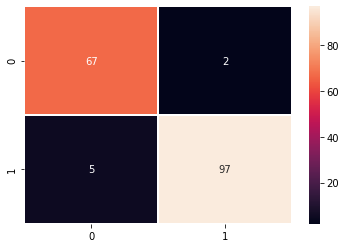

In [30]:
optimised_svm = grid.best_estimator_
optimised_svm.fit(X_train_scaled,y_train)

grid_predictions = optimised_svm.predict(X_test_scaled)
cm = confusion_matrix(y_test, grid_predictions)
sns.heatmap(cm, annot=True, lw=0.5)

print(classification_report(y_test, grid_predictions))

In [31]:
results = pd.DataFrame(grid_predictions)
results.index = X_test_scaled.index
results.columns =['predictions']
results.sort_index().to_csv('Breast_Cancer_Prediction_Results.csv')